In [1]:
import os
import cv2
import numpy as np
import pandas as pd
import random
import tqdm
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import albumentations as album

In [2]:
import segmentation_models_pytorch as smp

In [3]:
# DATA_DIR = '../input/massachusetts-buildings-dataset/tiff/'

# x_train_dir = os.path.join(DATA_DIR, 'train')
# y_train_dir = os.path.join(DATA_DIR, 'train_labels')

# x_valid_dir = os.path.join(DATA_DIR, 'val')
# y_valid_dir = os.path.join(DATA_DIR, 'val_labels')

# x_test_dir = os.path.join(DATA_DIR, 'test')
# y_test_dir = os.path.join(DATA_DIR, 'test_labels')

x_train_dir = r"C:\Users\lhc25\Desktop\segmentation\train\512images_old"
y_train_dir = r"C:\Users\lhc25\Desktop\segmentation\train\512labels_old"

# x_valid_dir = os.path.join(DATA_DIR, 'val')
# y_valid_dir = os.path.join(DATA_DIR, 'val_labels')

# x_test_dir = r"C:\Users\lhc25\Desktop\segmentation -plus\test\sharp_image"
x_test_dir =  r"C:\Users\lhc25\Desktop\segmentation\train\test\512images"
y_test_dir = r"C:\Users\lhc25\Desktop\segmentation\train\test\ans"

In [4]:
class_dict = pd.read_csv(r"C:\Users\lhc25\Desktop\segmentation\train\label_class_dict.csv")
# Get class names
class_names = class_dict['name'].tolist()
# Get class RGB values
class_rgb_values = class_dict[['r','g','b']].values.tolist()

print('All dataset classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

All dataset classes and their corresponding RGB values in labels:
Class Names:  ['background', 'blood']
Class RGB values:  [[0, 0, 0], [255, 255, 255]]


In [5]:
# Useful to shortlist specific classes in datasets with large number of classes
select_classes = ['background', 'blood']

# Get RGB values of required classes
select_class_indices = [class_names.index(cls.lower()) for cls in select_classes]
select_class_rgb_values =  np.array(class_rgb_values)[select_class_indices]

print('Selected classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

Selected classes and their corresponding RGB values in labels:
Class Names:  ['background', 'blood']
Class RGB values:  [[0, 0, 0], [255, 255, 255]]


In [6]:
# helper function for data visualization
def visualize(**images):
    """
    Plot images in one row
    """
    n_images = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([]); 
        plt.yticks([])
        # get title from the parameter names
        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

# Perform one hot encoding on label
def one_hot_encode(label, label_values):
    """
    Convert a segmentation image label array to one-hot format
    by replacing each pixel value with a vector of length num_classes
    # Arguments
        label: The 2D array segmentation image label
        label_values
        
    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of num_classes
    """
    semantic_map = []
    for colour in label_values:
        equality = np.equal(label, colour)
        class_map = np.all(equality, axis = -1)
        semantic_map.append(class_map)
    semantic_map = np.stack(semantic_map, axis=-1)

    return semantic_map
    
# Perform reverse one-hot-encoding on labels / preds
def reverse_one_hot(image):
    """
    Transform a 2D array in one-hot format (depth is num_classes),
    to a 2D array with only 1 channel, where each pixel value is
    the classified class key.
    # Arguments
        image: The one-hot format image 
        
    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of 1, where each pixel value is the classified 
        class key.
    """
    x = np.argmax(image, axis = -1)
    return x

# Perform colour coding on the reverse-one-hot outputs
def colour_code_segmentation(image, label_values):
    """
    Given a 1-channel array of class keys, colour code the segmentation results.
    # Arguments
        image: single channel array where each value represents the class key.
        label_values

    # Returns
        Colour coded image for segmentation visualization
    """
    colour_codes = np.array(label_values)
    x = colour_codes[image.astype(int)]

    return x

In [7]:
class BuildingsDataset(torch.utils.data.Dataset):

    """Massachusetts Buildings Dataset. Read images, apply augmentation and preprocessing transformations.
    
    Args:
        images_dir (str): path to images folder
        masks_dir (str): path to segmentation masks folder
        class_rgb_values (list): RGB values of select classes to extract from segmentation mask
        augmentation (albumentations.Compose): data transfromation pipeline 
            (e.g. flip, scale, etc.)
        preprocessing (albumentations.Compose): data preprocessing 
            (e.g. noralization, shape manipulation, etc.)
    
    """
    
    def __init__(
            self, 
            images_dir, 
            masks_dir, 
            class_rgb_values=None, 
            augmentation=None, 
            preprocessing=None,
    ):
        
        self.image_paths = [os.path.join(images_dir, image_id) for image_id in sorted(os.listdir(images_dir))]
        self.mask_paths = [os.path.join(masks_dir, image_id) for image_id in sorted(os.listdir(masks_dir))]

        
        self.class_rgb_values = class_rgb_values
        self.augmentation = augmentation
        self.preprocessing = preprocessing
    
    def __getitem__(self, i):
        
        # read images and masks
        image = cv2.cvtColor(cv2.imread(self.image_paths[i]), cv2.COLOR_BGR2RGB)
        mask = cv2.cvtColor(cv2.imread(self.mask_paths[i]), cv2.COLOR_BGR2RGB)
        
        # one-hot-encode the mask
        mask = one_hot_encode(mask, self.class_rgb_values).astype('float')
        
        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
            
        return image, mask
        
    def __len__(self):
        # return length of 
        return len(self.image_paths)
    def getname(self, i):
        # 获取不带扩展名的文件名
        filename, _ = os.path.splitext(os.path.basename(self.image_paths[i]))
        return filename   

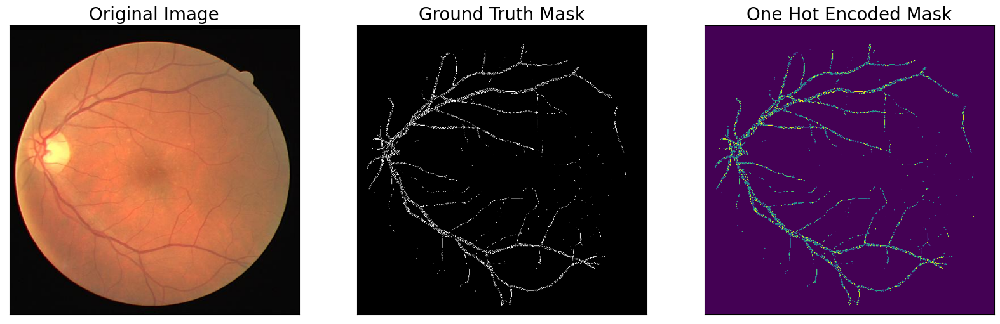

In [8]:
dataset = BuildingsDataset(x_train_dir, y_train_dir, class_rgb_values=select_class_rgb_values)
random_idx = random.randint(0, len(dataset)-1)
image, mask = dataset[2]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [9]:
def get_training_augmentation():
    train_transform = [    
        album.RandomCrop(height=256, width=256, always_apply=True),
        album.OneOf(
            [
                album.HorizontalFlip(p=1),
                album.VerticalFlip(p=1),
                album.RandomRotate90(p=1),
            ],
            p=0.75,
        ),
    ]
    return album.Compose(train_transform)


def get_validation_augmentation():   
    # Add sufficient padding to ensure image is divisible by 32
    test_transform = [
#         album.PadIfNeeded(min_height=1536, min_width=1536, always_apply=True, border_mode=0),
        album.PadIfNeeded(min_height=512, min_width=512, always_apply=True, border_mode=0),
    ]
    return album.Compose(test_transform)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn=None):
    """Construct preprocessing transform    
    Args:
        preprocessing_fn (callable): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    """   
    _transform = []
    if preprocessing_fn:
        _transform.append(album.Lambda(image=preprocessing_fn))
    _transform.append(album.Lambda(image=to_tensor, mask=to_tensor))
        
    return album.Compose(_transform)

(256, 256, 3)


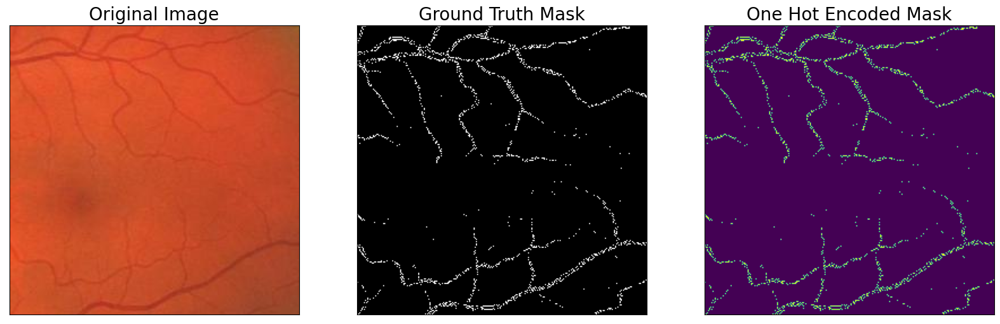

(256, 256, 3)


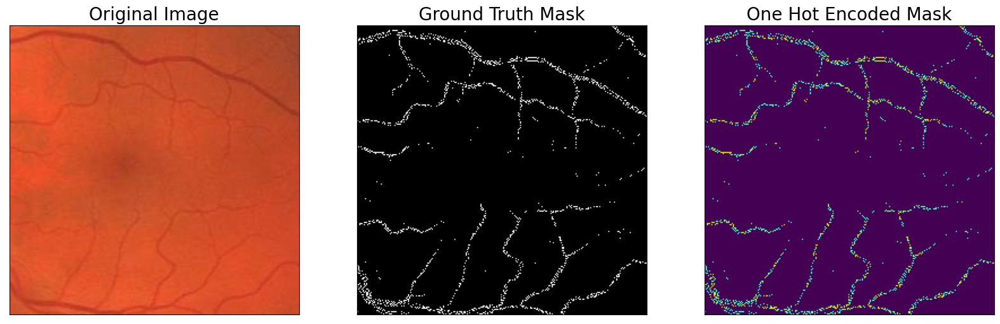

(256, 256, 3)


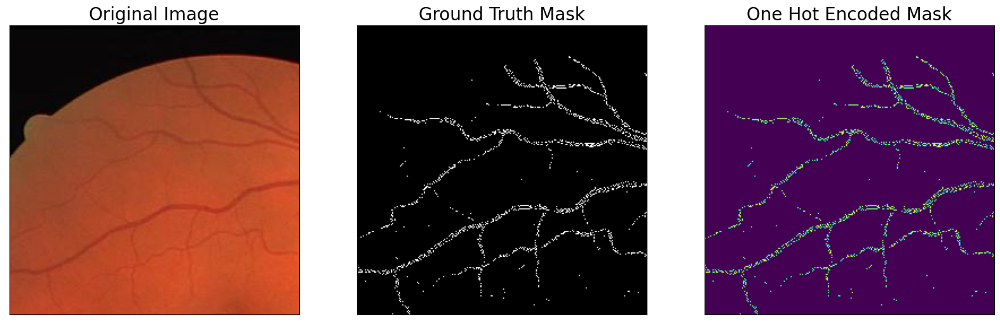

In [10]:
augmented_dataset = BuildingsDataset(
    x_train_dir, y_train_dir, 
    augmentation=get_training_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

random_idx = random.randint(0, len(augmented_dataset)-1)

# Different augmentations on a random image/mask pair (256*256 crop)
for i in range(3):
    image, mask = augmented_dataset[random_idx]
    print(image.shape)
    visualize(
        original_image = image,
        ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
        one_hot_encoded_mask = reverse_one_hot(mask)
    )

In [11]:
ENCODER = 'resnet101'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = class_names
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation
#模型定义
# create segmentation model with pretrained encoder
# model = smp.DeepLabV3Plus(
#     encoder_name=ENCODER, 
#     encoder_weights=ENCODER_WEIGHTS, 
#     classes=len(CLASSES), 
#     activation=ACTIVATION,
# )
model = smp.UnetPlusPlus(
    encoder_name=ENCODER,
    encoder_weights=ENCODER_WEIGHTS,
    classes=len(CLASSES),
    activation=ACTIVATION,
)
# model = smp.UnetPlusPlus(
#     encoder_name=ENCODER,
#     encoder_weights=ENCODER_WEIGHTS,
#     classes=len(CLASSES),
#     activation=ACTIVATION,
# )

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

In [12]:
print(model)

UnetPlusPlus(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential

In [46]:
# Get train and val dataset instances
full_dataset = BuildingsDataset(
    x_train_dir, y_train_dir, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)
# # Get train and val dataset instances
# train_dataset = BuildingsDataset(
#     x_train_dir, y_train_dir, 
#     augmentation=get_training_augmentation(),
#     preprocessing=get_preprocessing(preprocessing_fn),
#     class_rgb_values=select_class_rgb_values,
# )

# valid_dataset = BuildingsDataset(
#     x_valid_dir, y_valid_dir, 
#     augmentation=get_validation_augmentation(), 
#     preprocessing=get_preprocessing(preprocessing_fn),
#     class_rgb_values=select_class_rgb_values,
# )

# # Get train and val data loaders
# train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=5)
# valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False, num_workers=2)

In [47]:
from torch.utils.data import random_split, DataLoader
from PIL import Image
import torch
# Get the total size of the dataset
dataset_size = dataset.__len__()

# Define the split ratio for train and validation
train_ratio = 0.8
train_size = int(train_ratio * dataset_size)
valid_size = dataset_size - train_size

# Use random_split to create train and validation datasets
train_dataset, valid_dataset = random_split(full_dataset, [train_size, valid_size])

# Create DataLoader for training and validation
batch_size = 2  # Adjust as needed
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False, num_workers=0)

In [48]:
import segmentation_models_pytorch.utils
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 100

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
loss = smp.utils.losses.DiceLoss()

# define metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

# define optimizer
optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.0001),#lr=0.0001
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

# load best saved model checkpoint from previous commit (if present)
if os.path.exists(r"C:\Users\lhc25\Desktop\segmentation\train\best_model.pth"):
    model = torch.load(r"C:\Users\lhc25\Desktop\segmentation\train\best_model.pth", map_location=DEVICE)

In [49]:
train_epoch = smp.utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

In [50]:
%%time

if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, './best_model.pth')
            print('Model saved!')


Epoch: 0
valid: 100%|██████████| 8/8 [00:01<00:00,  6.42it/s, dice_loss - 0.5691, iou_score - 0.3165]
Model saved!

Epoch: 1
valid: 100%|██████████| 8/8 [00:01<00:00,  6.84it/s, dice_loss - 0.5289, iou_score - 0.4409]
Model saved!

Epoch: 2
valid: 100%|██████████| 8/8 [00:01<00:00,  6.84it/s, dice_loss - 0.4983, iou_score - 0.4607]
Model saved!

Epoch: 3
valid: 100%|██████████| 8/8 [00:01<00:00,  7.06it/s, dice_loss - 0.4785, iou_score - 0.4813]
Model saved!

Epoch: 4
valid: 100%|██████████| 8/8 [00:01<00:00,  6.91it/s, dice_loss - 0.4753, iou_score - 0.5001]
Model saved!

Epoch: 5
valid: 100%|██████████| 8/8 [00:01<00:00,  6.78it/s, dice_loss - 0.4586, iou_score - 0.5074]
Model saved!

Epoch: 6
valid: 100%|██████████| 8/8 [00:01<00:00,  7.29it/s, dice_loss - 0.4619, iou_score - 0.5049]

Epoch: 7
valid: 100%|██████████| 8/8 [00:01<00:00,  6.96it/s, dice_loss - 0.4512, iou_score - 0.5168]
Model saved!

Epoch: 8
valid: 100%|██████████| 8/8 [00:01<00:00,  7.06it/s, dice_loss - 0.4242, io

KeyboardInterrupt: 

In [ ]:
# torch.save(model, r'C:\Users\lhc25\best_model.pth')
# best_model = torch.load(r"C:\Users\lhc25\Desktop\model_stack\Unet++\best_model.pth", map_location=DEVICE)

In [53]:
# load best saved model checkpoint from the current run
if os.path.exists('./best_model.pth'):
    best_model = torch.load('./best_model.pth', map_location=DEVICE)
    print('Loaded model from this run.')

# load best saved model checkpoint from previous commit (if present)
elif os.path.exists('../input//deeplabv3-efficientnetb4-frontend-using-pytorch/best_model.pth'):
    best_model = torch.load('../input//deeplabv3-efficientnetb4-frontend-using-pytorch/best_model.pth', map_location=DEVICE)
    print('Loaded  model from a previous commit.')

Loaded model from this run.


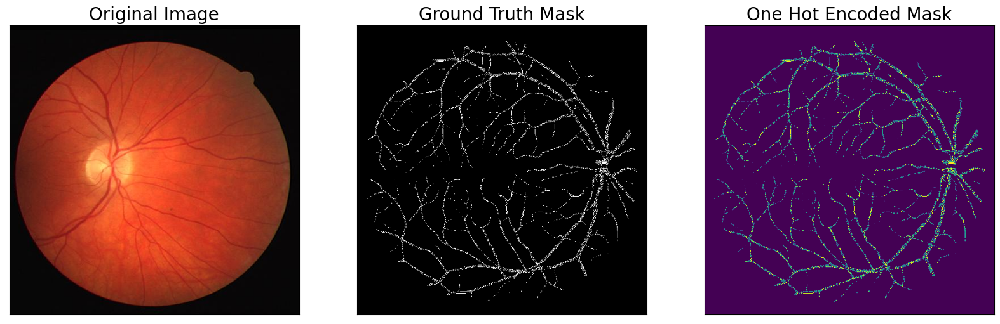

In [54]:
# create test dataloader (with preprocessing operation: to_tensor(...))
test_dataset = BuildingsDataset(
    x_test_dir, 
    y_test_dir, 
    augmentation=get_validation_augmentation(), 
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

test_dataloader = DataLoader(test_dataset)

# test dataset for visualization (without preprocessing transformations)
test_dataset_vis = BuildingsDataset(
    x_test_dir, y_test_dir, 
    augmentation=get_validation_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

# get a random test image/mask index
random_idx = random.randint(0, len(test_dataset_vis)-1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [55]:
sample_preds_folder = r"C:\Users\lhc25\Desktop\segmentation\sample_predictions/"
if not os.path.exists(sample_preds_folder):
    os.makedirs(sample_preds_folder)

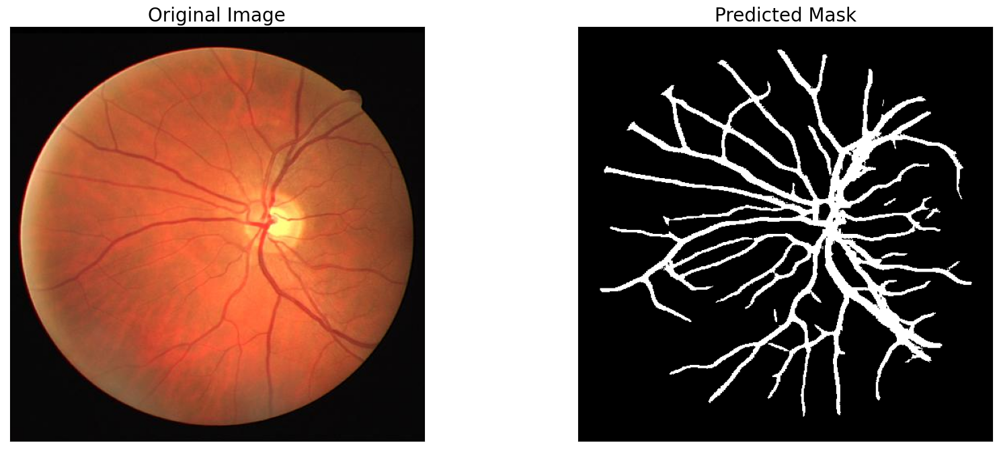

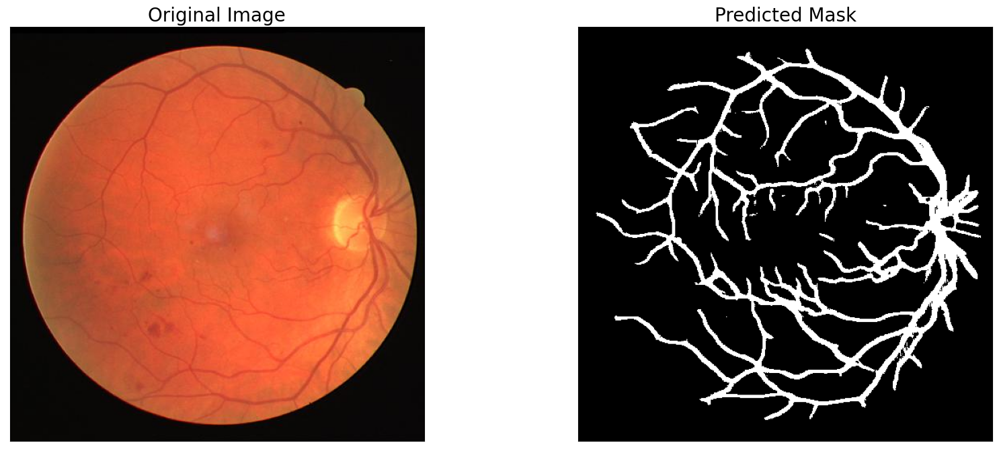

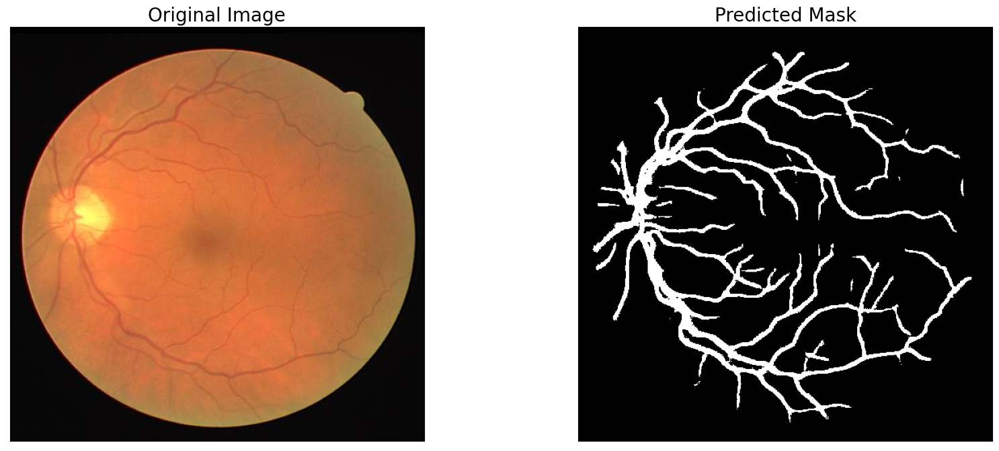

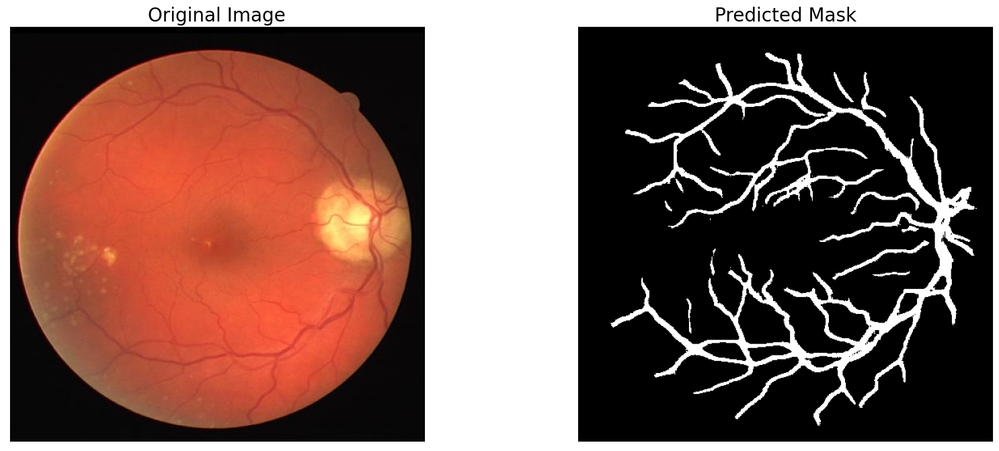

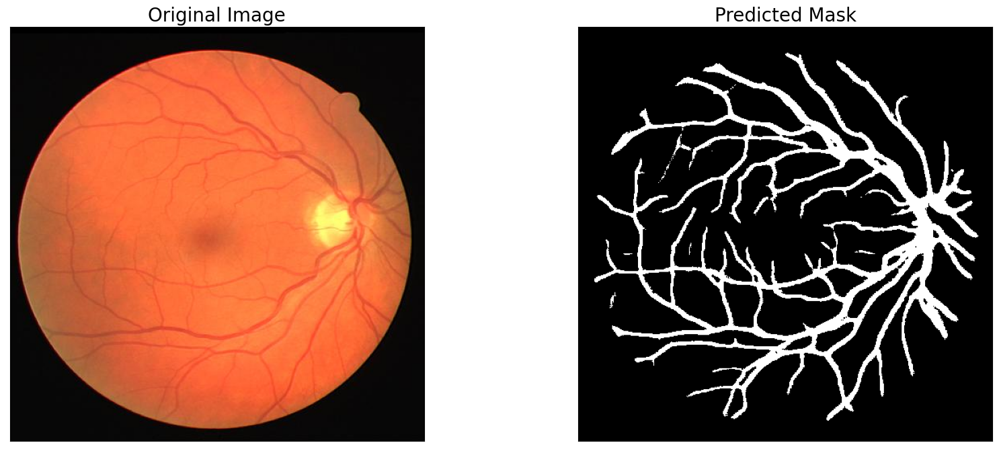

...

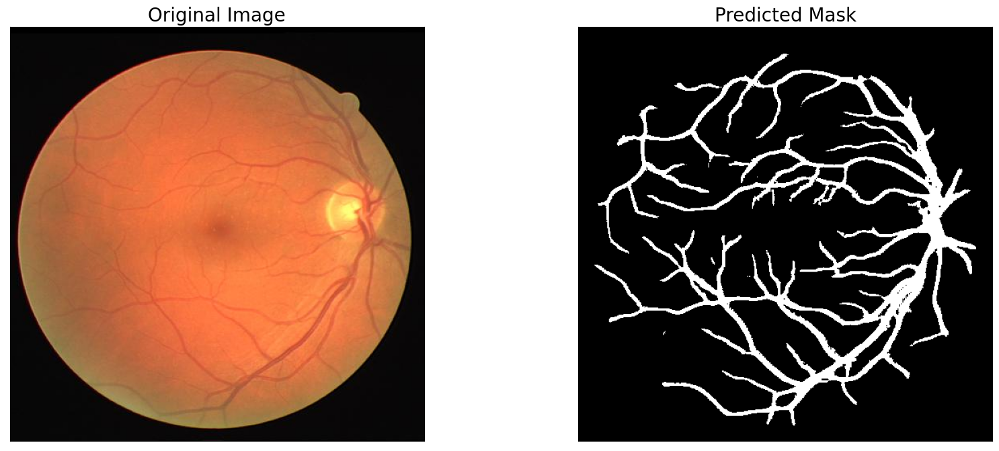

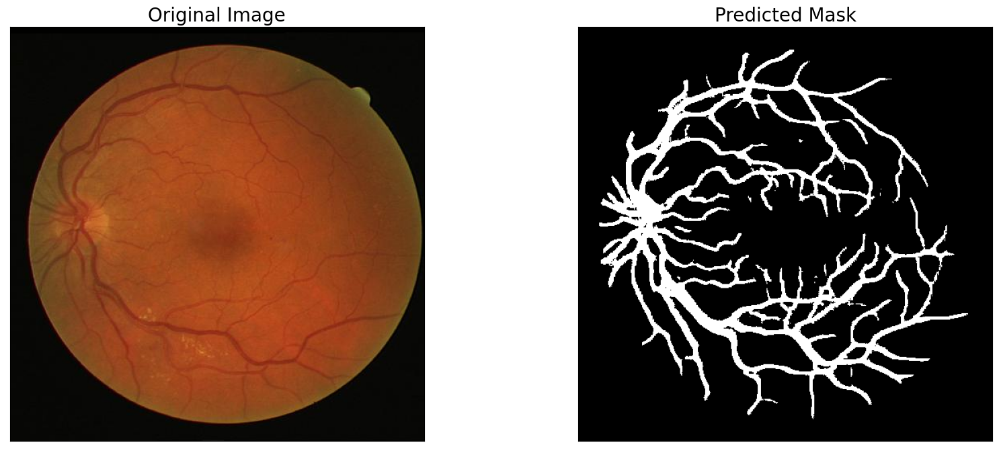

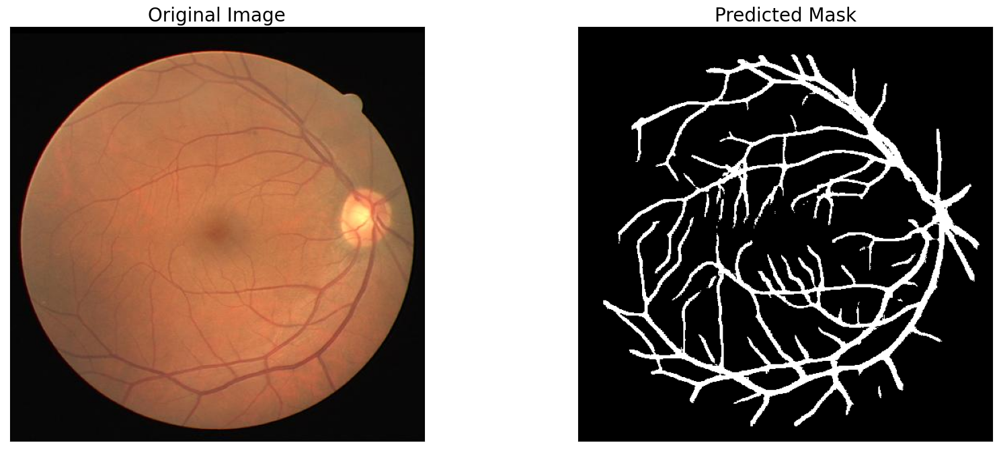

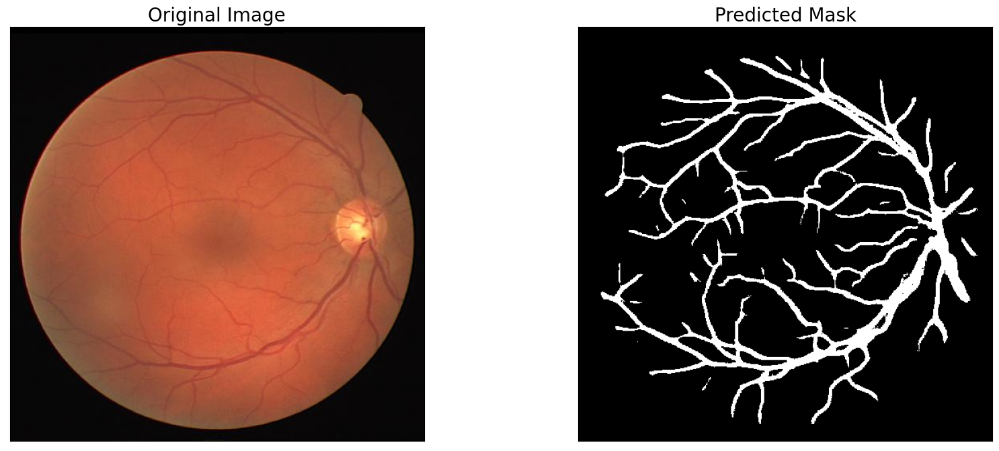

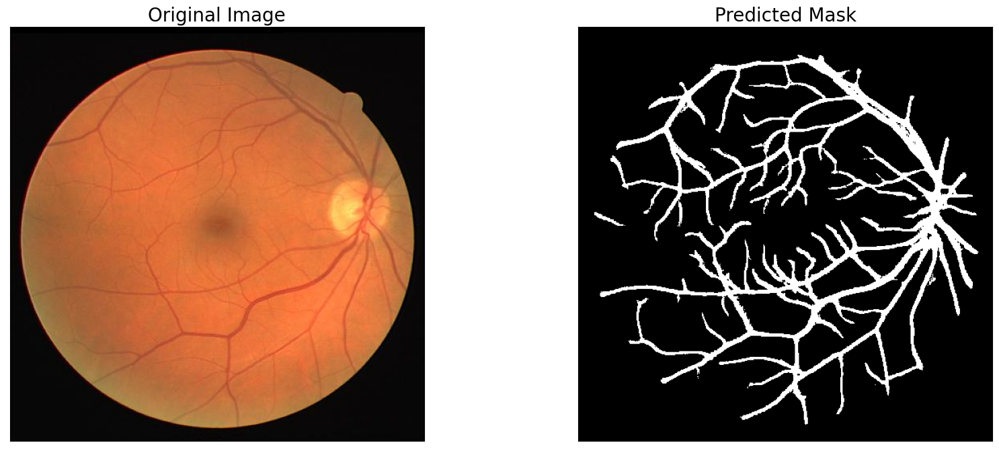

UnetPlusPlus(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential

In [56]:
model.eval()
with torch.no_grad():
    for idx in range(len(test_dataset)):
        
        image, gt_mask = test_dataset[idx]
        name=test_dataset.getname(idx)
        image_vis = crop_image(test_dataset_vis[idx][0].astype('uint8'))
        x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
        # Predict test image
        pred_mask = best_model(x_tensor)
        pred_mask = pred_mask.detach().squeeze().cpu().numpy()
        # Convert pred_mask from `CHW` format to `HWC` format
        pred_mask = np.transpose(pred_mask,(1,2,0))
#         # Get prediction channel corresponding to building
        pred_building_heatmap = pred_mask[:,:,select_classes.index('blood')]
        pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))
        # Convert gt_mask from `CHW` format to `HWC` format
        gt_mask = np.transpose(gt_mask,(1,2,0))
        gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
# # #         cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])
#         # Assuming pred_mask is your 1500x1500 image
#         # Get the center coordinates
#         center_x, center_y = pred_mask.shape[1] // 2, pred_mask.shape[0] // 2

#         # Calculate the cropping boundaries
#         crop_size = 512
#         start_x, start_y = center_x - crop_size // 2, center_y - crop_size // 2
#         end_x, end_y = start_x + crop_size, start_y + crop_size

#         # Crop the image
#         cropped_pred_mask = pred_mask[start_y:end_y, start_x:end_x]

# #         Save the cropped image
#         cv2.imwrite(os.path.join(sample_preds_folder, f"{name}.png"), cropped_pred_mask)
        cv2.imwrite(os.path.join(sample_preds_folder, f"{name}.png"), pred_mask)
        
    
    
#         visualize(
#             original_image = image_vis,
#             ground_truth_mask = gt_mask,
#             predicted_mask = pred_mask,
#             predicted_building_heatmap = pred_building_heatmap
#         )
        
        visualize(
            original_image = image_vis,
            predicted_mask = pred_mask,
        )
model.train()

In [ ]:
# test_epoch = smp.utils.train.ValidEpoch(
#     model,
#     loss=loss, 
#     metrics=metrics, 
#     device=DEVICE,
#     verbose=True,
# )

# valid_logs = test_epoch.run(test_dataloader)
# print("Evaluation on Test Data: ")
# print(f"Mean IoU Score: {valid_logs['iou_score']:.4f}")
# print(f"Mean Dice Loss: {valid_logs['dice_loss']:.4f}")

valid:   0%|          | 0/40 [00:00<?, ?it/s]

valid: 100%|██████████| 40/40 [00:17<00:00,  2.35it/s, dice_loss - 0.6043, iou_score - 0.1356]
Evaluation on Test Data: 
Mean IoU Score: 0.1356
Mean Dice Loss: 0.6043


In [ ]:
# train_logs_df = pd.DataFrame(train_logs_list)
# valid_logs_df = pd.DataFrame(valid_logs_list)
# train_logs_df.T

""


In [31]:
# plt.figure(figsize=(20,8))
# plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
# plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
# plt.xlabel('Epochs', fontsize=20)
# plt.ylabel('IoU Score', fontsize=20)
# plt.title('IoU Score Plot', fontsize=20)
# plt.legend(loc='best', fontsize=16)
# plt.grid()
# plt.savefig('iou_score_plot.png')
# plt.show()

In [32]:
# plt.figure(figsize=(20,8))
# plt.plot(train_logs_df.index.tolist(), train_logs_df.dice_loss.tolist(), lw=3, label = 'Train')
# plt.plot(valid_logs_df.index.tolist(), valid_logs_df.dice_loss.tolist(), lw=3, label = 'Valid')
# plt.xlabel('Epochs', fontsize=20)
# plt.ylabel('Dice Loss', fontsize=20)
# plt.title('Dice Loss Plot', fontsize=20)
# plt.legend(loc='best', fontsize=16)
# plt.grid()
# plt.savefig('dice_loss_plot.png')
# plt.show()

In [57]:
import numpy as np
import pandas as pd
from PIL import Image
import torchvision
import os
"""
In order to reduce the submission file size, our metric uses run-length encoding on the pixel values.
Instead of submitting an exhaustive list of indices for your segmentation, you will submit pairs of values 
that contain a start position and a run length.
E.g. '1 3' implies starting at pixel 1 and running a total of 3 pixels 1,2,3. The competition format requires a space
delimited list of pairs. For example, '1 3 10 5' implies pixels 1,2,3,10,11,12,13,14 are to be included in the mask. 
The metric checks that the pairs are sorted, positive, and the decoded pixel values are not duplicated. 
----------------------------------------------------------------------------------------------------------------
Put the predicted segmentation images into the "image" folder(You need to create one) and run this python file.
"""

def get_img_file(image_dir):
    imagelist = []
    namelist = []
    for parent, dirnames, filenames in os.walk(image_dir):
        for filename in filenames:
            if filename.lower().endswith(
                    ('.bmp', '.dib', '.png', '.jpg', '.jpeg', '.pbm', '.pgm', '.ppm', '.tif', '.gif')):
                imagelist.append(os.path.join(parent, filename))
                namelist.append(filename)
        return imagelist, namelist


def turn_to_str(image_list):
    outputs = []
    for image_path in image_list:
        image = Image.open(image_path).convert('L')
        transform = torchvision.transforms.ToTensor()
        image = image.resize((512, 512), Image.Resampling.BILINEAR)
        image = transform(image)
        image[image > 0] = 1
        dots = np.where(image.flatten() == 1)[0]
        run_lengths = []
        prev = -2
        for b in dots:
            if (b > prev + 1):
                run_lengths.extend((b + 1, 0))
            run_lengths[-1] += 1
            prev = b
        output = ' '.join([str(r) for r in run_lengths])
        outputs.append(output)
    return outputs


def save_to_csv(name_list, str_list):
    df = pd.DataFrame(columns=['Id', 'Predicted'])
    df['Id'] = [i.split('.')[0] for i in name_list]
    df['Predicted'] = str_list
    df.to_csv(r"C:\Users\lhc25\Desktop\Unet++.csv", index=None)


if __name__=="__main__":
    image_dir=r"C:\Users\lhc25\Desktop\segmentation\sample_predictions"
    image_list, name_list = get_img_file(image_dir)
    str_list = turn_to_str(image_list)
    save_to_csv(name_list, str_list)